# This code is exactly similar to the other code but formatted in a foor loop so we can predict all images please look at the other code for better explanation


In [1]:
from matplotlib import pyplot as plt
import numpy as np
import cv2
import math
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from timeit import default_timer as timer
from sklearn.metrics import mean_absolute_error
%matplotlib inline
import matplotlib.image as mpimg
from matplotlib import rcParams

In [2]:
minImageIndex = 1
maxImageIndex = 50

In [3]:
size = 1 #size of image between 0 and 1 for the source only predicted image will be full quality
window_size = 4
p = (window_size + window_size + 1)**2

Predicted_images = []
GroundTruth_images = []
Scores = []

rcParams['figure.figsize'] = 13 ,10
scores_sum = 0

In [4]:
#a function that finds the mean absolute errors between 2 images where 0 means the image is perfect
#the higher the error the worse the prediction is
def mae(y_true, y_pred):
    mae = np.sum(np.absolute((y_true.astype("float") - y_pred.astype("float"))))
    mae /= float(y_true.shape[0] * y_pred.shape[1]) 
    return mae / 3.0

#We take every pixel in our image and find the WxW neighbours where (i,j) pixel is in the center 
#(X,Y) nested loops find the surrounded pixels for pixle(i,j)
#we return a 3d array where every (i,j) pixel has a 3rd dimension array that includes all the neighbour pixels
#example features_vector[500][500][25] where 81 is P size and [500][500] is image size
def extract_vectorfeatures(img):
    m,n = img.shape
    vector_features = np.zeros((m,n,p)) 
    for i in range(window_size,m-window_size):
        for j in range(window_size,n-window_size):
            k = 0
            vector_features[i][j][k] = int(img[i,j])
            for x in range(1,window_size):
                for y in range(1,window_size):
                    k += 1
                    if(x != 0 or y != 0):
                        vector_features[i][j][k] = int(img[i+x,j+y])
                        vector_features[i][j][k] = int(img[i-x,j+y])
                        vector_features[i][j][k] = int(img[i-x,j-y])
                        vector_features[i][j][k] = int(img[i+x,j-y])
            for x in range(1,window_size):
                    k += 1
                    vector_features[i][j][k] = int(img[i+x,j])
                    vector_features[i][j][k] = int(img[i-x,j])
                    vector_features[i][j][k] = int(img[i,j+x])
                    vector_features[i][j][k] = int(img[i,j-x])
    return vector_features

#extracting other features from our features_vector that we created above
def mean(features):
    return features.mean(axis=1)    
def varriance(features):
    return features.var(axis=1)


#to find the edges first we need to remove the noise, so we blur our image
# then using sobel derivatives where a small shift of gradient returns a white pixel indicating an 
# vh is for Horizontal changes
# vv si for Vertical changes
#we can compine them to get a full image
#refrence  :https://docs.opencv.org/3.4/d2/d2c/tutorial_sobel_derivatives.html
def edges(img):
    blured = cv2.GaussianBlur(img, (0, 0), 0.2)
    vh = cv2.Sobel(blured, -1, 1, 0)
    vv = cv2.Sobel(blured, -1, 0, 1)
    v = 0.5*vv + 0.5*vh
    return v

In [5]:
start = timer()
for num in range(minImageIndex,maxImageIndex+1):
    
    if num < 10:
        img_number = '0'+ str(num)
    else:
        img_number = str(num)
        
    #reading images
    img = cv2.imread('images/p0'+img_number+', a_source.png')
    target_img = cv2.imread('images/p0'+img_number+', b_target.png')
    groundTruth_img = cv2.imread('images/p0'+img_number+', c_groundtruth.png') 

#resize images for faster results if needed
    img = cv2.resize(img, (0,0), fx=size, fy=size) 
    #target_img = cv2.resize(target_img, (0,0), fx=size, fy=size)
    #groundTruth_img = cv2.resize(groundTruth_img, (0,0), fx=size, fy=size)

#converting source image to greyscale
    source_gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    m,n = source_gray_img.shape#width,height of source image

#converting target image to greyscale because the orginial target image has 3 channels of RGB
    target_img = cv2.cvtColor(target_img,cv2.COLOR_BGR2GRAY)
    w,h = target_img.shape#width,height of target image
    
    #get the features_vector of the source greyscale image and reshape it to 2D
    source_vectorfeatures = extract_vectorfeatures(source_gray_img)
    source_vectorfeatures = source_vectorfeatures.reshape(-1,p)
    source_vectorfeatures.shape

    #return the grey channel values as features 
    X = np.reshape(source_gray_img, source_gray_img.shape)

    #split our colored image to get seperate BGR labels to train the model
    B, G, R = cv2.split(img)

    #reshape our vectors to 1D channels width*height
    X = np.reshape(X,m*n)
    B = np.reshape(B,m*n)
    G = np.reshape(G,m*n)
    R = np.reshape(R,m*n)

    R.shape,B.shape,G.shape,X.shape

    mean_features = mean(source_vectorfeatures)

    var_features = varriance(source_vectorfeatures)

    edges_features = edges(source_gray_img)
    edges_features = np.reshape(edges_features,m*n)
    
    #stack all features together
    X = np.column_stack((X,var_features,mean_features,edges_features))
    
    #preprocessing our data
    scaler = StandardScaler()
    scaler.fit(X)
    X =  scaler.transform(X)
    
    #get the features_vector of the target greyscale image and reshape it to 2D
    #then we extract same features as above
    target_vectorfeatures = extract_vectorfeatures(target_img)
    target_vectorfeatures = target_vectorfeatures.reshape(-1,p)

    X_test = np.reshape(target_img, target_img.shape)
    X_test = np.reshape(X_test,w*h)

    var_features = varriance(target_vectorfeatures)

    mean_features = mean(target_vectorfeatures)

    edges_features = edges(target_img)
    edgesimg=edges_features
    edges_features = np.reshape(edges_features,w*h)

    X_test = np.column_stack((X_test,var_features,mean_features,edges_features))

    scaler = StandardScaler()
    scaler.fit(X_test)
    X_test =  scaler.transform(X_test)

    #here we create 3 different model for B,G,R channels 
    #Using knn classifier where every model is for a different 
    #BGR channel
    model1 = KNeighborsClassifier(n_neighbors=3)
    model2 = KNeighborsClassifier(n_neighbors=3)
    model3 = KNeighborsClassifier(n_neighbors=3)

    model1.fit(X,B)
    model2.fit(X,G)
    model3.fit(X,R)
    
    yhat_B= model1.predict(X_test)
    yhat_G= model2.predict(X_test)
    yhat_R= model3.predict(X_test)


    #we reshape all the channels to the original image width x height
    yhat_B = np.reshape(yhat_B,(w,h))
    yhat_G = np.reshape(yhat_G,(w,h))
    yhat_R = np.reshape(yhat_R,(w,h))


    predicted_img = cv2.merge((yhat_B,yhat_G,yhat_R))
    predicted_img = cv2.cvtColor(predicted_img, cv2.COLOR_BGR2RGB)#conver from BGR to RGB
    Predicted_images.append(predicted_img)

    groundTruth_img  = cv2.cvtColor(groundTruth_img, cv2.COLOR_BGR2RGB)
    GroundTruth_images.append(groundTruth_img)
    Scores.append(mae(groundTruth_img,predicted_img))
    print("Image ",num, " Completed")

end = timer()
#should show "Image \number\ Completed" as an output

Image  1  Completed
Image  2  Completed
Image  3  Completed
Image  4  Completed
Image  5  Completed
Image  6  Completed
Image  7  Completed
Image  8  Completed
Image  9  Completed
Image  10  Completed
Image  11  Completed
Image  12  Completed
Image  13  Completed
Image  14  Completed
Image  15  Completed
Image  16  Completed
Image  17  Completed
Image  18  Completed
Image  19  Completed
Image  20  Completed
Image  21  Completed
Image  22  Completed
Image  23  Completed
Image  24  Completed
Image  25  Completed
Image  26  Completed
Image  27  Completed
Image  28  Completed
Image  29  Completed
Image  30  Completed
Image  31  Completed
Image  32  Completed
Image  33  Completed
Image  34  Completed
Image  35  Completed
Image  36  Completed
Image  37  Completed
Image  38  Completed
Image  39  Completed
Image  40  Completed
Image  41  Completed
Image  42  Completed
Image  43  Completed
Image  44  Completed
Image  45  Completed
Image  46  Completed
Image  47  Completed
Image  48  Completed
I

<ipython-input-6-8cd02a12df86>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,2)


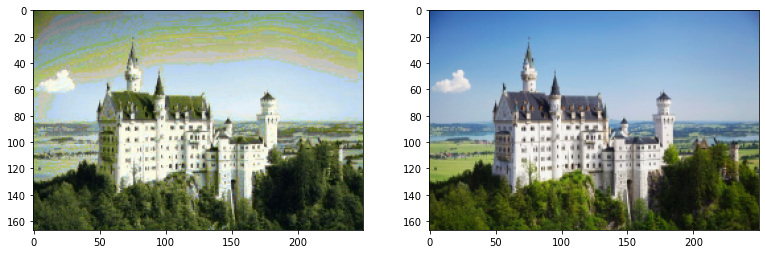

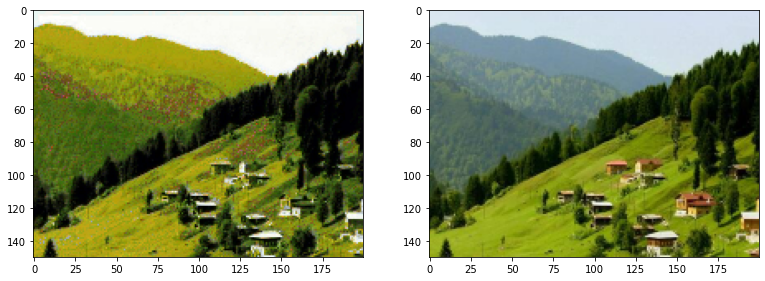

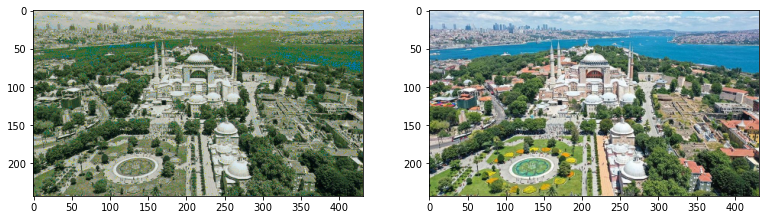

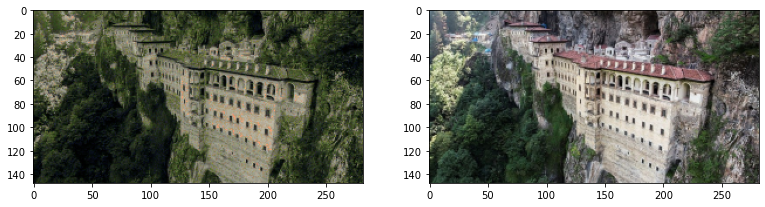

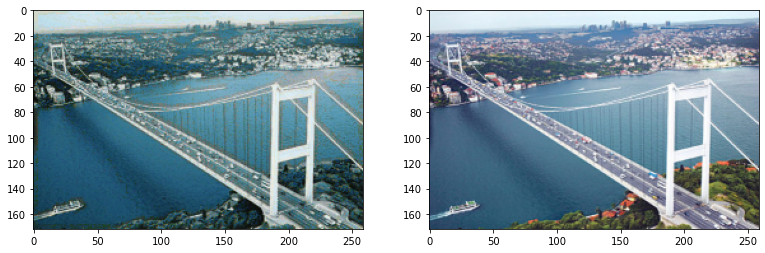

...

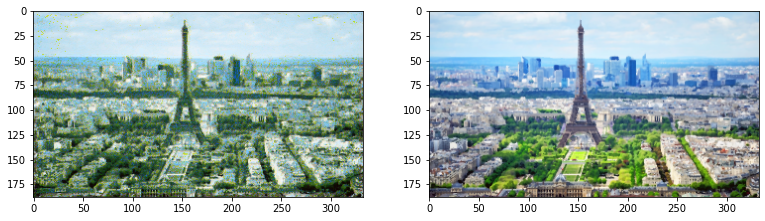

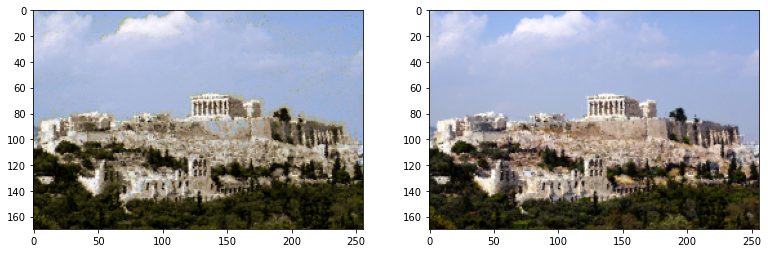

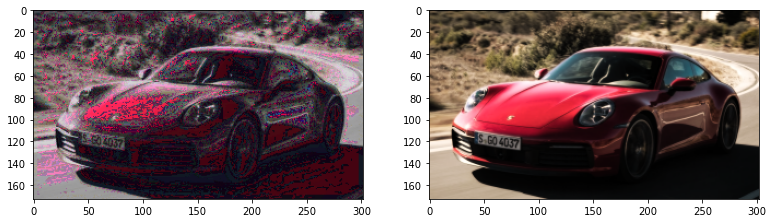

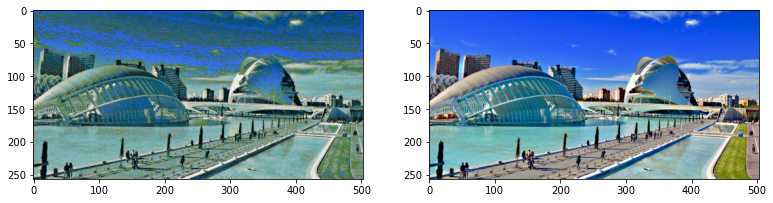

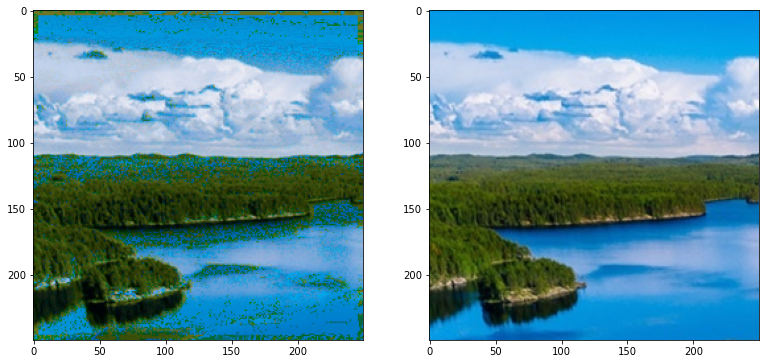

In [6]:
rcParams['figure.figsize'] = 13 ,10
scores_sum = 0
for i in range(minImageIndex,maxImageIndex+1):
    scores_sum += Scores[i-minImageIndex]
    fig, ax = plt.subplots(1,2)
    ax[0].imshow(Predicted_images[i-minImageIndex]);
    ax[1].imshow(GroundTruth_images[i-minImageIndex]);
    Predicted_images[i-minImageIndex] = cv2.cvtColor(Predicted_images[i-minImageIndex], cv2.COLOR_BGR2RGB)#conver from BGR to RGB
    cv2.imwrite('predictedImages/' + str(i) + '.png', Predicted_images[i-minImageIndex])
    
#Predicted image is on the left and Ground Truth image is on the Right    

In [7]:
f = open('ProjectTestImagesResults.txt', 'a')
for i in range(minImageIndex,maxImageIndex+1):
    f.write(str(Scores[i-minImageIndex]) + '\n')
    print("MAE for Image ",i,":",Scores[i-minImageIndex])

MAE for Image  1 : 24.109732534930142
MAE for Image  2 : 24.14851111111111
MAE for Image  3 : 24.936201290453692
MAE for Image  4 : 33.420180819116986
MAE for Image  5 : 22.00705605938164
MAE for Image  6 : 32.57176470588235
MAE for Image  7 : 24.934030612244896
MAE for Image  8 : 17.228989541160594
MAE for Image  9 : 52.82373617602591
MAE for Image  10 : 24.394733107967113
MAE for Image  11 : 17.96730760233918
MAE for Image  12 : 46.84659634519709
MAE for Image  13 : 19.33578796645335
MAE for Image  14 : 55.636936226166995
MAE for Image  15 : 44.8976269621422
MAE for Image  16 : 20.60637058414836
MAE for Image  17 : 44.96976456009913
MAE for Image  18 : 36.076421409106544
MAE for Image  19 : 22.78728001050696
MAE for Image  20 : 27.678653971354166
MAE for Image  21 : 28.041003220525
MAE for Image  22 : 17.99464782701777
MAE for Image  23 : 32.76431230060262
MAE for Image  24 : 32.21839234321666
MAE for Image  25 : 11.960882781935412
MAE for Image  26 : 33.44396313364055
MAE for Image 

In [8]:
print("Average MAE Score is :", scores_sum / maxImageIndex)
print("Elapsed time:",end - start,"   Seconds")

f.write('\n' + str(scores_sum / maxImageIndex) + '\n')

Average MAE Score is : 25.1028186086272
Elapsed time: 465.8672811    Seconds


18